<a href="https://colab.research.google.com/github/Mike-Ziegler/MANE_4962_PROJECT_SPRING24/blob/main/Tensor_Flow_Class_Seaborn.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Tensor Flow Neural Network For Classification**

Neural Network using SGD with ReduceLROnPlateau

The first 13 columns contain the collected sensor data, the next 8 columns contain deep features extracted using CAE hyperparameters for the two datasets
For CAE1_32_64_20_512_8_10_20.xlsx
s1_cae1, s2_cae1, s3_cae1, s4_cae1, s5_cae1, s6_cae1, s7_cae1 = 32, 64, 20, 512, 8, 10, 20

For CAE2_32_64_20_512_8_100_256.xlsx
s1_cae2, s2_cae2, s3_cae2, s4_cae2, s5_cae2, s6_cae2, s7_cae2 = 32, 64, 20, 512, 8, 100, 256

The last column of data is the classifier Contains the class.
Class = 0: biocomposite
Class = 1: fiber epoxy composite

Processing file: CAE2_32_64_20_512_8_100_256.xlsx
Loss: 0.3672185242176056
Accuracy: 0.8363446593284607


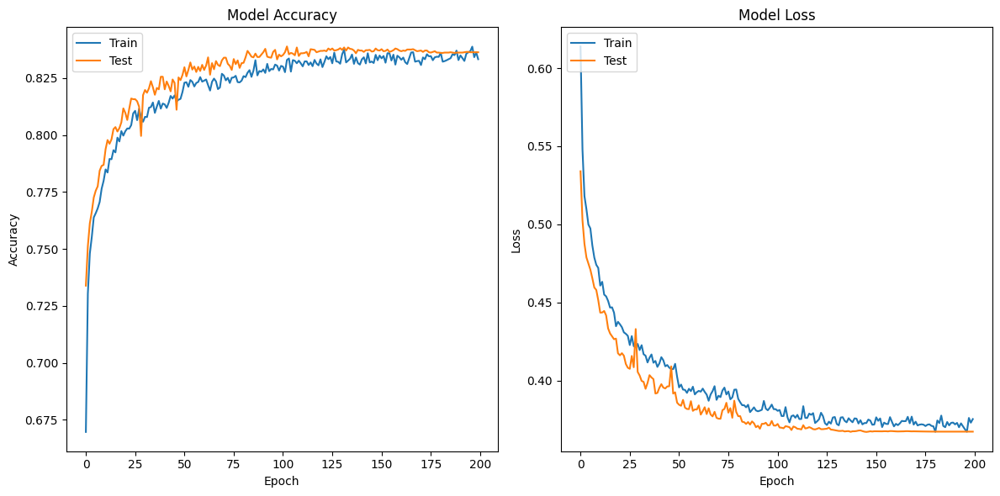

313/313 [==============================] - 1s 1ms/step


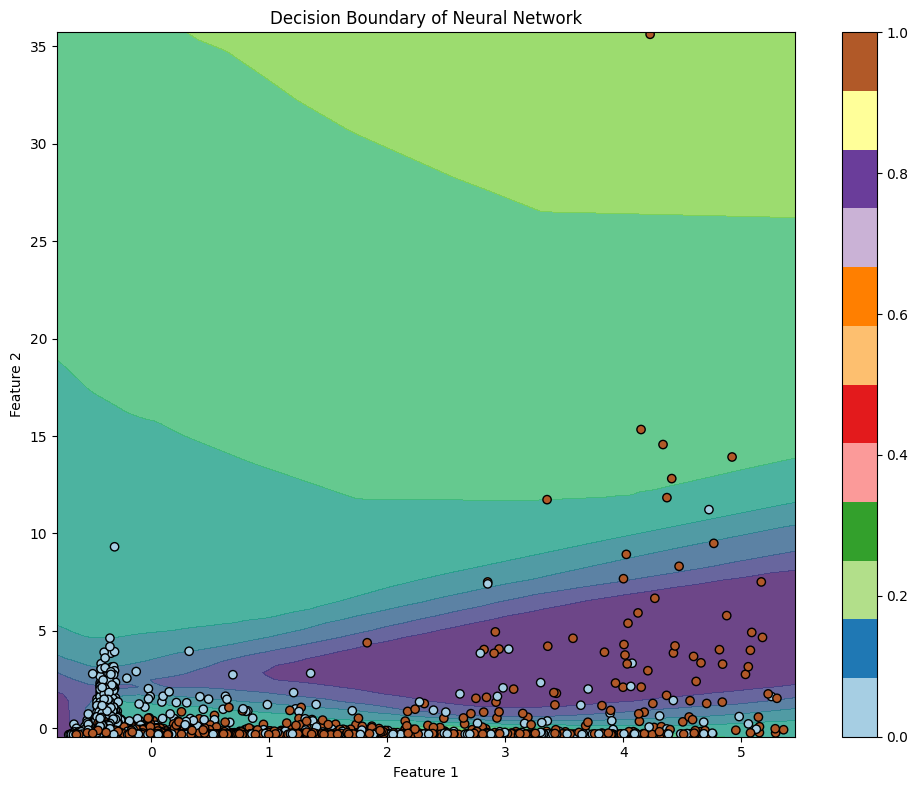

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


Model saved as: CAE2_32_64_20_512_8_100_256_model.h5
--------------------------------------------------
Processing file: CAE1_32_64_20_512_8_10_20.xlsx
Loss: 0.370100736618042
Accuracy: 0.8361952900886536


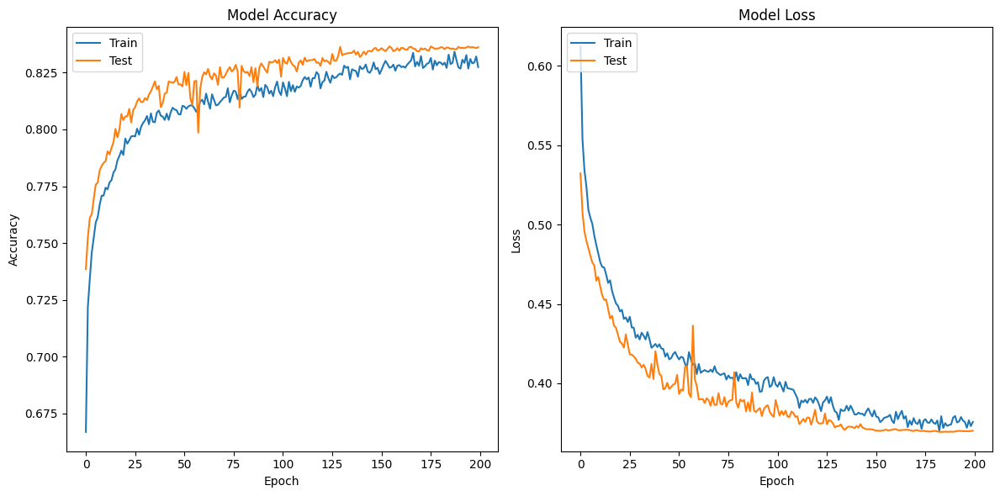

313/313 [==============================] - 1s 1ms/step


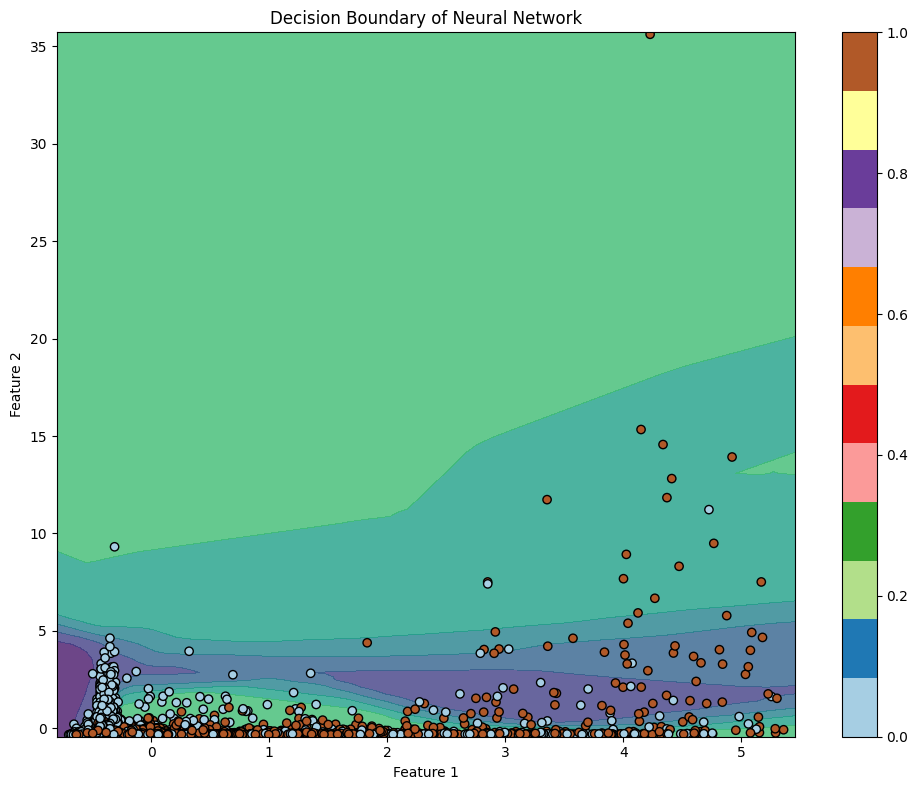

Model saved as: CAE1_32_64_20_512_8_10_20_model.h5
--------------------------------------------------


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
import tensorflow as tf
from tensorflow.keras.callbacks import ReduceLROnPlateau
import matplotlib.pyplot as plt


def load_and_process_data(file_name):
    # Load the dataset
    df = pd.read_excel(file_name, header=[0, 1])

    # Separate features and labels
    X = df.values[:, :-1]  # Features (remove the last column which is the class label)
    y = df.values[:, -1]   # Class labels (last column)

    # Shuffle the dataset
    X, y = shuffle(X, y, random_state=42)

    # Scale the features
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # Convert labels to binary format
    y_binary = (y - np.min(y)) / (np.max(y) - np.min(y))

    # Split the dataset into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X_scaled, y_binary, test_size=0.3, random_state=42)

    return X_train, X_test, y_train, y_test

def build_tf_nn(input_shape, learning_rate=0.1):
    model = tf.keras.Sequential([
        tf.keras.layers.Dense(64, activation='relu', input_shape=input_shape),
        tf.keras.layers.Dropout(.5),
        tf.keras.layers.Dense(32, activation='relu'),
        tf.keras.layers.Dropout(.3),
        tf.keras.layers.Dense(1, activation='sigmoid')
    ])

    # Set the optimizer to SGD with custom learning rate
    optimizer = tf.keras.optimizers.SGD(learning_rate=learning_rate)

    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    return model

def train_model(X_train, y_train, X_test, y_test):
    input_shape = (X_train.shape[1],)

    # Define the ReduceLROnPlateau callback
    reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=10, verbose=0)

    model = build_tf_nn(input_shape)

    history = model.fit(X_train, y_train, epochs=200, batch_size=64, verbose=0,
                        validation_data=(X_test, y_test), callbacks=[reduce_lr])

    return model, history


def plot_decision_boundary(X, y, model):
    x_min, x_max = X[:, 0].min() - 0.1, X[:, 0].max() + 0.1
    y_min, y_max = X[:, 1].min() - 0.1, X[:, 1].max() + 0.1
    xx, yy = np.meshgrid(np.linspace(x_min, x_max, 100),
                         np.linspace(y_min, y_max, 100))

    X_grid = np.zeros((xx.ravel().shape[0], X.shape[1]))
    for i in range(X.shape[1]):
        X_grid[:, i] = xx.ravel() if i == 0 else yy.ravel() if i == 1 else np.zeros_like(xx.ravel())

    Z = model.predict(X_grid)
    Z = Z.reshape(xx.shape)

    plt.figure(figsize=(10, 8))
    plt.contourf(xx, yy, Z, alpha=0.8)
    plt.scatter(X[:, 0], X[:, 1], c=y, edgecolors='k', cmap=plt.cm.Paired)
    plt.xlabel('Feature 1')
    plt.ylabel('Feature 2')
    plt.title('Decision Boundary of Neural Network')
    plt.colorbar()
    plt.tight_layout()
    plt.show()

def plot_training_history(history):
    plt.figure(figsize=(12, 6))

    # Plot training & validation accuracy values
    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('Model Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend(['Train', 'Test'], loc='upper left')

    # Plot training & validation loss values
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend(['Train', 'Test'], loc='upper left')

    plt.tight_layout()
    plt.show()

def main():
    file_names = [
        "CAE2_32_64_20_512_8_100_256.xlsx",
        "CAE1_32_64_20_512_8_10_20.xlsx"
    ]

    for file_name in file_names:
        print("Processing file:", file_name)

        X_train, X_test, y_train, y_test = load_and_process_data(file_name)

        model, history = train_model(X_train, y_train, X_test, y_test)

        # Evaluate the model on test data
        loss, accuracy = model.evaluate(X_test, y_test, verbose=0)
        print("Loss:", loss)
        print("Accuracy:", accuracy)
        # Plot the training history
        plot_training_history(history)
        # Plot decision boundary
        plot_decision_boundary(X_test, y_test, model)

        # Save the trained model for this file
        model.save(file_name.split(".xlsx")[0] + "_model.h5")
        print("Model saved as:", file_name.split(".xlsx")[0] + "_model.h5")

        print("--------------------------------------------------")

if __name__ == "__main__":
    main()


**Best Results**

Processing file: CAE2_32_64_20_512_8_100_256.xlsx

Loss: 0.3672185242176056

Accuracy: 0.8363446593284607

**Building a New TF model using softmax.**

Processing file: CAE1_32_64_20_512_8_10_20.xlsx
210/210 [==============================] - 0s 2ms/step - loss: 0.3868 - accuracy: 0.8280
Test Accuracy: 0.8279826641082764
210/210 [==============================] - 0s 1ms/step


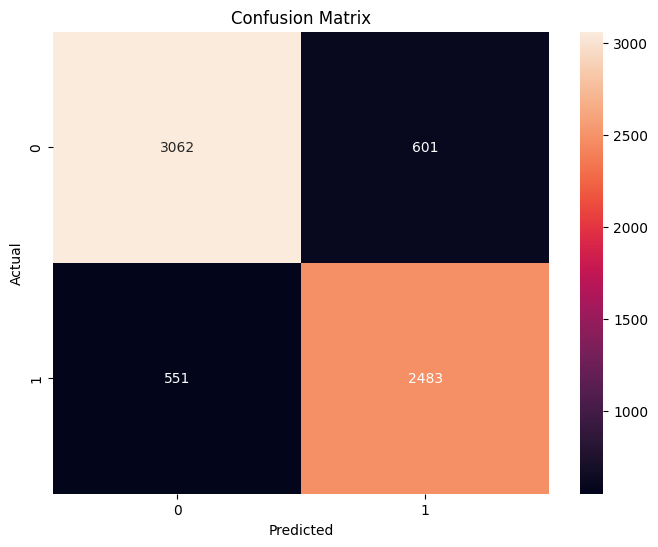

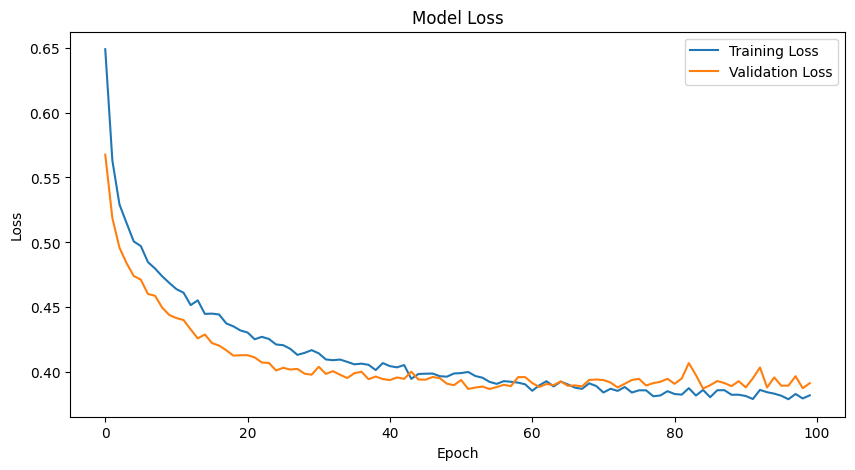

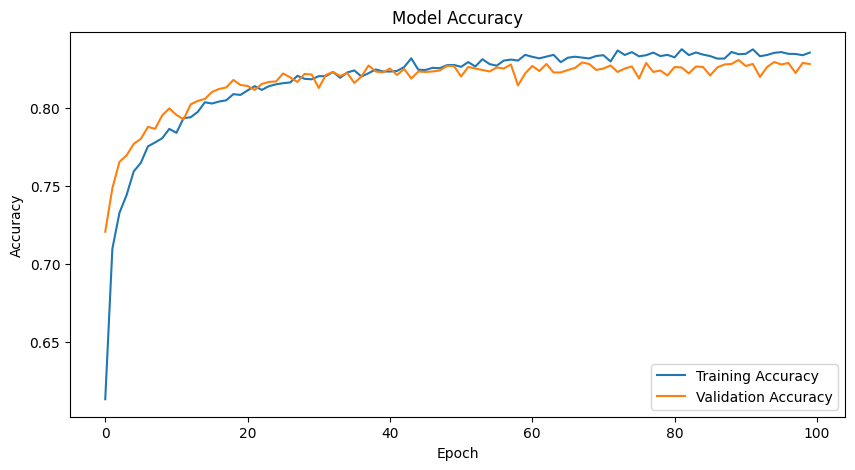

--------------------------------------------------------------------------------
Processing file: CAE2_32_64_20_512_8_100_256.xlsx
210/210 [==============================] - 1s 2ms/step - loss: 0.3840 - accuracy: 0.8310
Test Accuracy: 0.8309690952301025
210/210 [==============================] - 1s 2ms/step


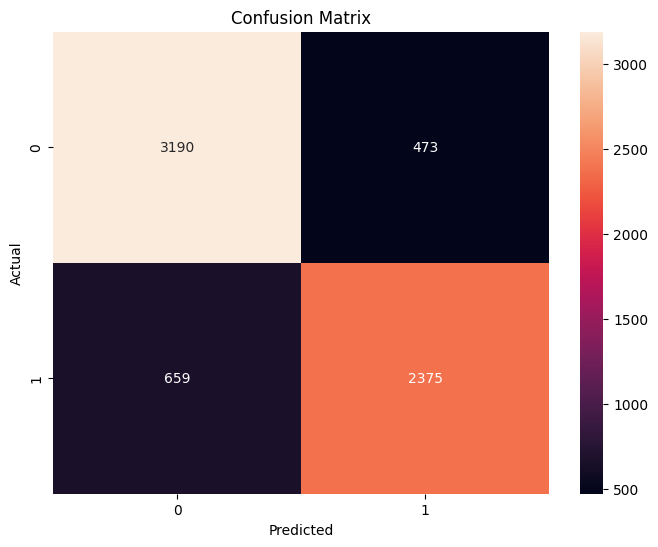

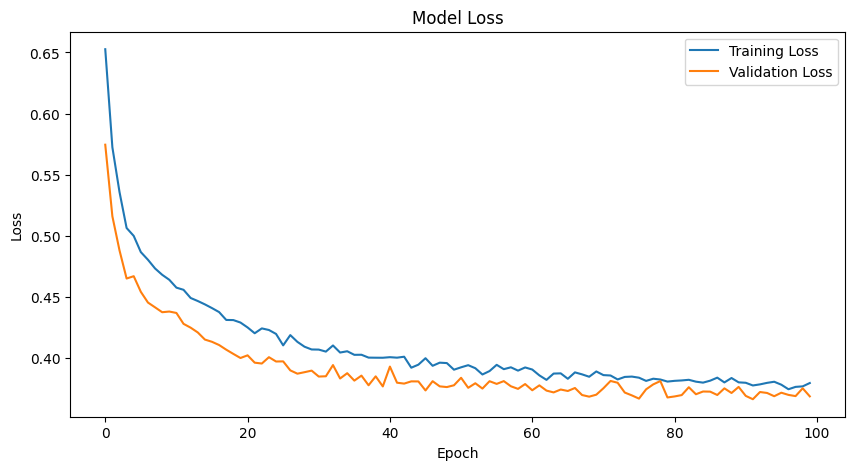

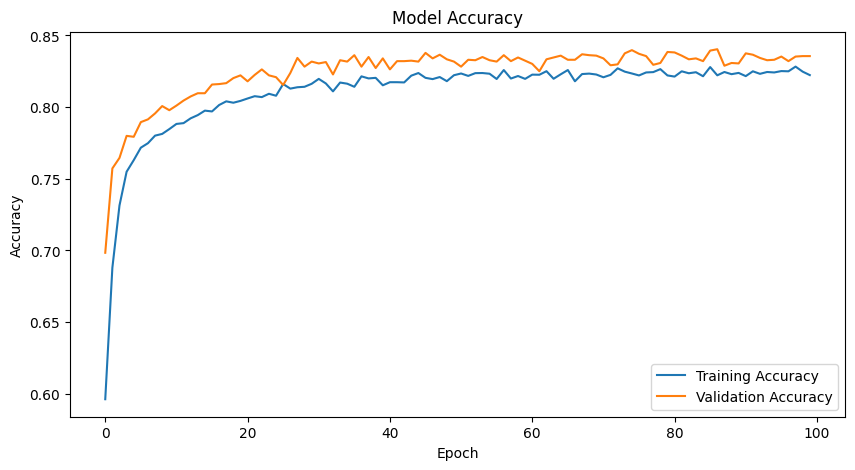

--------------------------------------------------------------------------------


In [ ]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, KFold
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, confusion_matrix
from mlxtend.feature_selection import SequentialFeatureSelector as SFS
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.utils import shuffle
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense

# Define the file names
file_names = [
    "CAE1_32_64_20_512_8_10_20.xlsx",
    "CAE2_32_64_20_512_8_100_256.xlsx",
]

def load_data(file_name):
    # Load data
    df = pd.read_excel(file_name, header=[0, 1])  # Load with multi-level header
    feature_names = df.columns.to_flat_index()  # Get multi-level index
    X = df.values[:, :-1]  # Features (remove the last column which is the class label)
    y = df.values[:, -1]   # Class labels (last column)
    return X, y, feature_names

def preprocess_data(X):
    # Scale the data
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)
    return X_scaled

# def evaluate_classification(X, y, clf):
#     # Evaluate classification performance
#     kf = KFold(n_splits=5, shuffle=True, random_state=42)
#     scores = cross_val_score(clf, X, y, cv=kf)
#     return scores.mean()

# def apply_ffs(X, y, clf):
#     # Apply Forward Feature Selection
#     sfs = SFS(clf,
#               k_features='best',
#               forward=True,
#               floating=False,
#               verbose=0,
#               scoring='accuracy',
#               cv=3) #lower cv for testing
#     sfs.fit(X, y)
#     return sfs.k_feature_names_, sfs.k_score_

for file_name in file_names:
    print("Processing file:", file_name)

    # Load data
    X, y, feature_names = load_data(file_name)

    # Shuffle and Split for preprocessing and CAE training
    X, y = shuffle(X, y, random_state=42)  # Shuffle the data

    # Preprocess data using the scaled data from the preprocessing part
    X_scaled = preprocess_data(X)

    # Split the preprocessed data for training and testing
    X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.3, random_state=42)

    # Define the TensorFlow MLP model
    model = Sequential([
        Dense(20, activation='relu', input_shape=(X_train.shape[1],)),
        Dense(10, activation='relu'),
        tf.keras.layers.Dropout(.3),
        Dense(5, activation='relu'),
        tf.keras.layers.Dropout(.2),
        Dense(2, activation='softmax')  # 2 for binary classification
    ])

    # Compile the model
    model.compile(optimizer='adam',
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])

    # Train the model
    history = model.fit(X_train, y_train, epochs=100, batch_size=32, validation_split=0.2, verbose=0)

    # Evaluate the model on the test data
    test_loss, test_accuracy = model.evaluate(X_test, y_test)

    print("Test Accuracy:", test_accuracy)

    # Make predictions
    y_pred_prob = model.predict(X_test)
    y_pred = np.argmax(y_pred_prob, axis=1)  # Convert probabilities to classes

    # Calculate confusion matrix
    cm = confusion_matrix(y_test, y_pred)

    # Plot Confusion Matrix
    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, fmt='g')
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.title('Confusion Matrix')
    plt.show()

    # Plot training history: loss
    plt.figure(figsize=(10, 5))
    plt.plot(history.history['loss'], label='Training Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('Model Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

    # Plot training history: accuracy
    plt.figure(figsize=(10, 5))
    plt.plot(history.history['accuracy'], label='Training Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.title('Model Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.show()

    print("-" * 80)


** Similar results with: loss: 0.3840 - accuracy: 0.8310 & Test Accuracy: 0.8309690952301025**

**Build & Test CNN**

Processing file: CAE1_32_64_20_512_8_10_20.xlsx
Loss: 0.4499831199645996
Accuracy: 0.7828667163848877


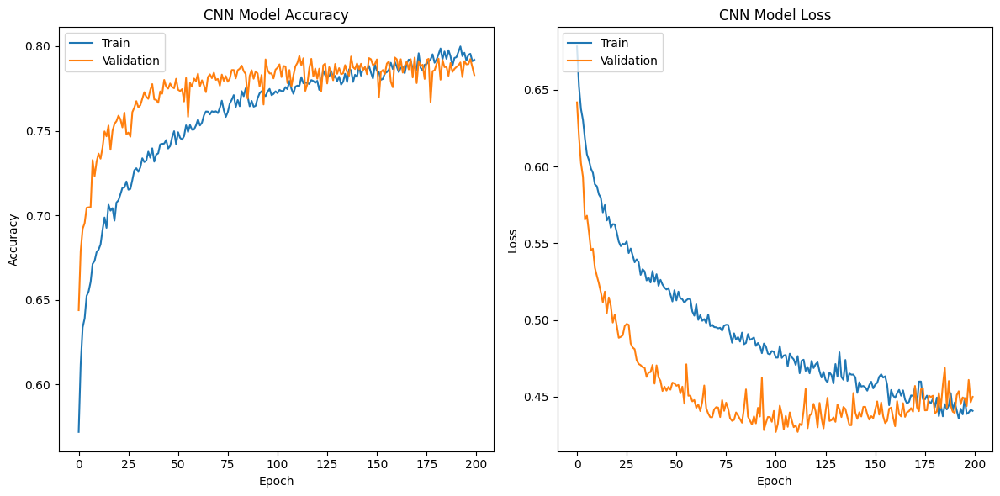

--------------------------------------------------
Processing file: CAE2_32_64_20_512_8_100_256.xlsx
Loss: 0.41000938415527344
Accuracy: 0.8134378790855408


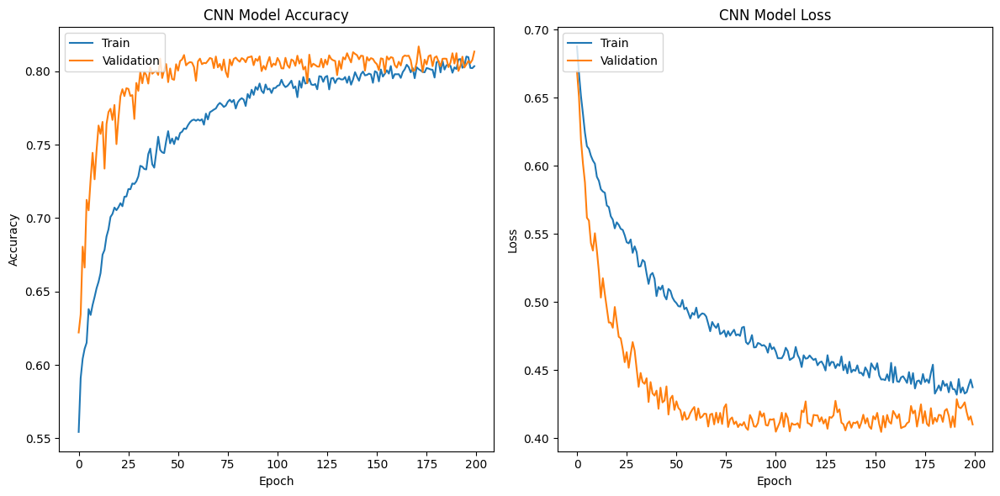

--------------------------------------------------
Trained CNN model saved as: cnn_trained_model.h5


/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
import tensorflow as tf

def load_and_process_data(file_name):
    # Load the dataset
    df = pd.read_excel(file_name, header=[0, 1])

    # Separate features and labels
    X = df.values[:, :-1]  # Features (remove the last column which is the class label)
    y = df.values[:, -1]   # Class labels (last column)

    # Shuffle the dataset
    X, y = shuffle(X, y, random_state=42)

    # Scale the features
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # Convert labels to binary format
    y_binary = (y - np.min(y)) / (np.max(y) - np.min(y))

    # Reshape the data for CNN
    X_reshaped = X_scaled.reshape(X_scaled.shape[0], X_scaled.shape[1], 1)

    # Split the dataset into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X_reshaped, y_binary, test_size=0.4, random_state=42)

    return X_train, X_test, y_train, y_test

def build_cnn(input_shape):
    model = tf.keras.Sequential([
        tf.keras.layers.Conv1D(32, 3, activation='relu', input_shape=input_shape),
        tf.keras.layers.MaxPooling1D(2),
        tf.keras.layers.Conv1D(64, 3, activation='relu'),
        tf.keras.layers.MaxPooling1D(2),
        tf.keras.layers.Flatten(),
        tf.keras.layers.Dense(16, activation='relu'),
        tf.keras.layers.Dropout(0.8),
        tf.keras.layers.Dense(8, activation='relu'),
        tf.keras.layers.Dropout(0.5),
        tf.keras.layers.Dense(1, activation='sigmoid')
    ])

    model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
    return model

def train_cnn(model, X_train, y_train, X_test, y_test):
    history = model.fit(X_train, y_train, epochs=200, batch_size=64, verbose=0, validation_data=(X_test, y_test))
    return model, history

def plot_training_history(history):
    plt.figure(figsize=(12, 6))

    # Plot training & validation accuracy values
    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('CNN Model Accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend(['Train', 'Validation'], loc='upper left')

    # Plot training & validation loss values
    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('CNN Model Loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend(['Train', 'Validation'], loc='upper left')

    plt.tight_layout()
    plt.show()

def main():
    file_names = [
        "CAE1_32_64_20_512_8_10_20.xlsx",
        "CAE2_32_64_20_512_8_100_256.xlsx",
    ]

    model = None  # Initialize model outside the loop

    for file_name in file_names:
        print("Processing file:", file_name)

        X_train, X_test, y_train, y_test = load_and_process_data(file_name)

        if model is None:
            # Build the model for the first time
            model = build_cnn(X_train.shape[1:])
        else:
            # Reset the model
            tf.keras.backend.clear_session()
            model = build_cnn(X_train.shape[1:])

        model, history = train_cnn(model, X_train, y_train, X_test, y_test)

        # Evaluate the model on test data
        loss, accuracy = model.evaluate(X_test, y_test, verbose=0)
        print("Loss:", loss)
        print("Accuracy:", accuracy)
        # Plot the training and validation accuracy and losses
        plot_training_history(history)

        print("--------------------------------------------------")

    # Save the trained model after processing all files
    model.save("cnn_trained_model.h5")
    print("Trained CNN model saved as: cnn_trained_model.h5")

if __name__ == "__main__":
    main()


**Not as good of results on first trial: Loss: 0.4499831199645996 & Accuracy: 0.7828667163848877**

**Using Random Search CV to tune hyper-parameters**

Processing file: CAE2_32_64_20_512_8_100_256.xlsx


/usr/local/lib/python3.10/dist-packages/scikeras/wrappers.py:925: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/usr/local/lib/python3.10/dist-packages/scikeras/wrappers.py:925: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/usr/local/lib/python3.10/dist-packages/scikeras/wrappers.py:925: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/usr/local/lib/python3.10/dist-packages/scikeras/wrappers.py:925: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/usr/local/lib/python3.10/dist-packages/scikeras

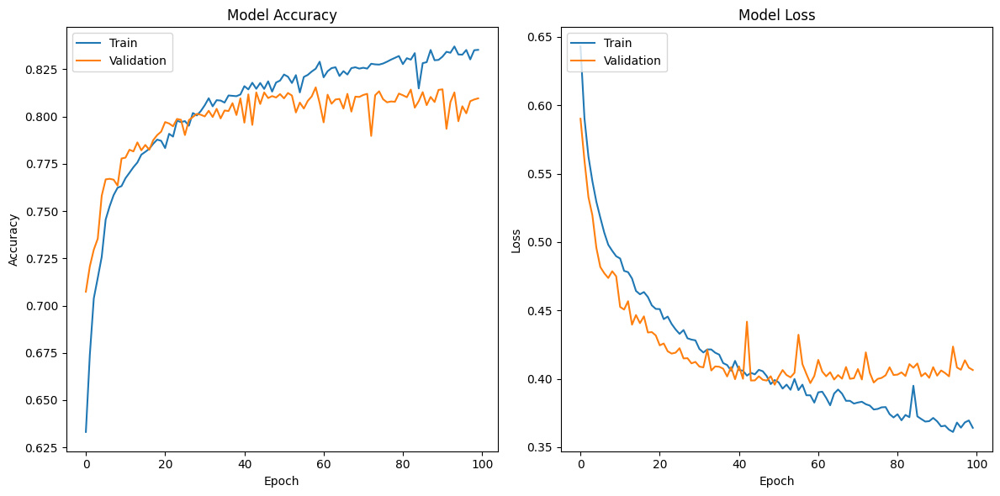

Processing file: CAE1_32_64_20_512_8_10_20.xlsx


/usr/local/lib/python3.10/dist-packages/scikeras/wrappers.py:925: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/usr/local/lib/python3.10/dist-packages/scikeras/wrappers.py:925: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/usr/local/lib/python3.10/dist-packages/scikeras/wrappers.py:925: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/usr/local/lib/python3.10/dist-packages/scikeras/wrappers.py:925: UserWarning: ``build_fn`` will be renamed to ``model`` in a future release, at which point use of ``build_fn`` will raise an Error instead.
  X, y = self._initialize(X, y)
/usr/local/lib/python3.10/dist-packages/scikeras

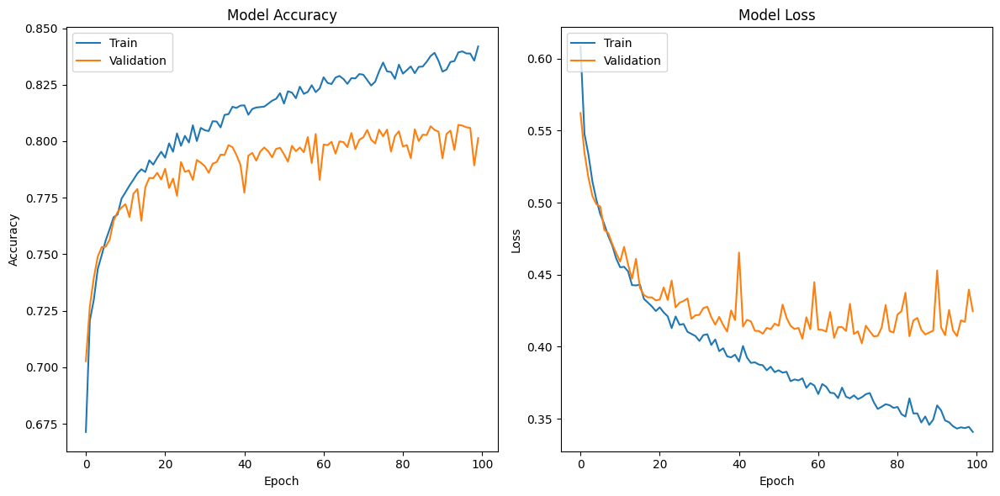

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split, RandomizedSearchCV
from sklearn.utils import shuffle
import tensorflow as tf
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv1D, MaxPooling1D, Flatten, Dense, Dropout, Input
from scikeras.wrappers import KerasClassifier

def load_and_process_data(file_name):
    # Load the dataset
    df = pd.read_excel(file_name, header=[0, 1])

    # Separate features and labels
    X = df.values[:, :-1]  # Features (remove the last column which is the class label)
    y = df.values[:, -1]   # Class labels (last column)

    # Shuffle the dataset
    X, y = shuffle(X, y, random_state=42)

    # Scale the features
    scaler = StandardScaler()
    X_scaled = scaler.fit_transform(X)

    # Convert labels to binary format
    y_binary = (y - np.min(y)) / (np.max(y) - np.min(y))

    # Reshape the data for CNN
    X_reshaped = X_scaled.reshape(X_scaled.shape[0], X_scaled.shape[1], 1)

    # Split the dataset into training and testing sets
    X_train, X_test, y_train, y_test = train_test_split(X_reshaped, y_binary, test_size=0.3, random_state=42)

    return X_train, X_test, y_train, y_test

def create_cnn_model(input_shape, dropout_rate, learning_rate):
    model = Sequential([
        Input(shape=input_shape),
        Conv1D(32, 3, activation='relu'),
        MaxPooling1D(2),
        Conv1D(64, 3, activation='relu'),
        MaxPooling1D(2),
        Flatten(),
        Dense(16, activation='relu'),
        Dropout(dropout_rate),
        Dense(1, activation='sigmoid')
    ])

    optimizer = tf.keras.optimizers.Adam(learning_rate=learning_rate)
    model.compile(optimizer=optimizer, loss='binary_crossentropy', metrics=['accuracy'])
    return model

def main():
    file_names = [
        "CAE2_32_64_20_512_8_100_256.xlsx",
        "CAE1_32_64_20_512_8_10_20.xlsx"
    ]

    for file_name in file_names:
        print("Processing file:", file_name)

        X_train, X_test, y_train, y_test = load_and_process_data(file_name)
        input_shape = (X_train.shape[1], 1)

        # Wrap Keras model so it can be used by scikit-learn RandomizedSearchCV
        keras_classifier = KerasClassifier(
            build_fn=create_cnn_model,
            input_shape=input_shape,
            dropout_rate=0.2,
            learning_rate=0.001,
            verbose=0
        )

        # Define the random search parameters
        param_dist = {
            'dropout_rate': [0.3, 0.4, 0.6, 0.7],
            'learning_rate': [ 0.001, 0.01, 0.1],
            'epochs': [10, 20, 100],
            'batch_size': [ 32, 64, 128]
        }

        # Perform random search
        random_search = RandomizedSearchCV(
            estimator=keras_classifier,
            param_distributions=param_dist,
            n_iter=10,
            cv=3,
            verbose=0
        )

        random_result = random_search.fit(X_train, y_train, validation_data=(X_test, y_test))

        # Get the best model
        best_model = random_result.best_estimator_

        if best_model is not None:
            # Train the best model separately to get training history
            model = create_cnn_model(input_shape=input_shape, dropout_rate=best_model.dropout_rate,
                                     learning_rate=best_model.learning_rate)

            history = model.fit(X_train, y_train, epochs=best_model.epochs, batch_size=best_model.batch_size,
                                validation_data=(X_test, y_test), verbose=0)

            # Plot training history
            plt.figure(figsize=(12, 6))

            # Plot training & validation accuracy values
            plt.subplot(1, 2, 1)
            plt.plot(history.history['accuracy'])
            plt.plot(history.history['val_accuracy'])
            plt.title('Model Accuracy')
            plt.xlabel('Epoch')
            plt.ylabel('Accuracy')
            plt.legend(['Train', 'Validation'], loc='upper left')

            # Plot training & validation loss values
            plt.subplot(1, 2, 2)
            plt.plot(history.history['loss'])
            plt.plot(history.history['val_loss'])
            plt.title('Model Loss')
            plt.xlabel('Epoch')
            plt.ylabel('Loss')
            plt.legend(['Train', 'Validation'], loc='upper left')

            plt.tight_layout()
            plt.show()
        else:
            print("Best model is None, check parameters or data.")

if __name__ == "__main__":
    main()


**Validation Score is still low.**

**Using Seabron to Visualize the sensor data with a sample of 1000**

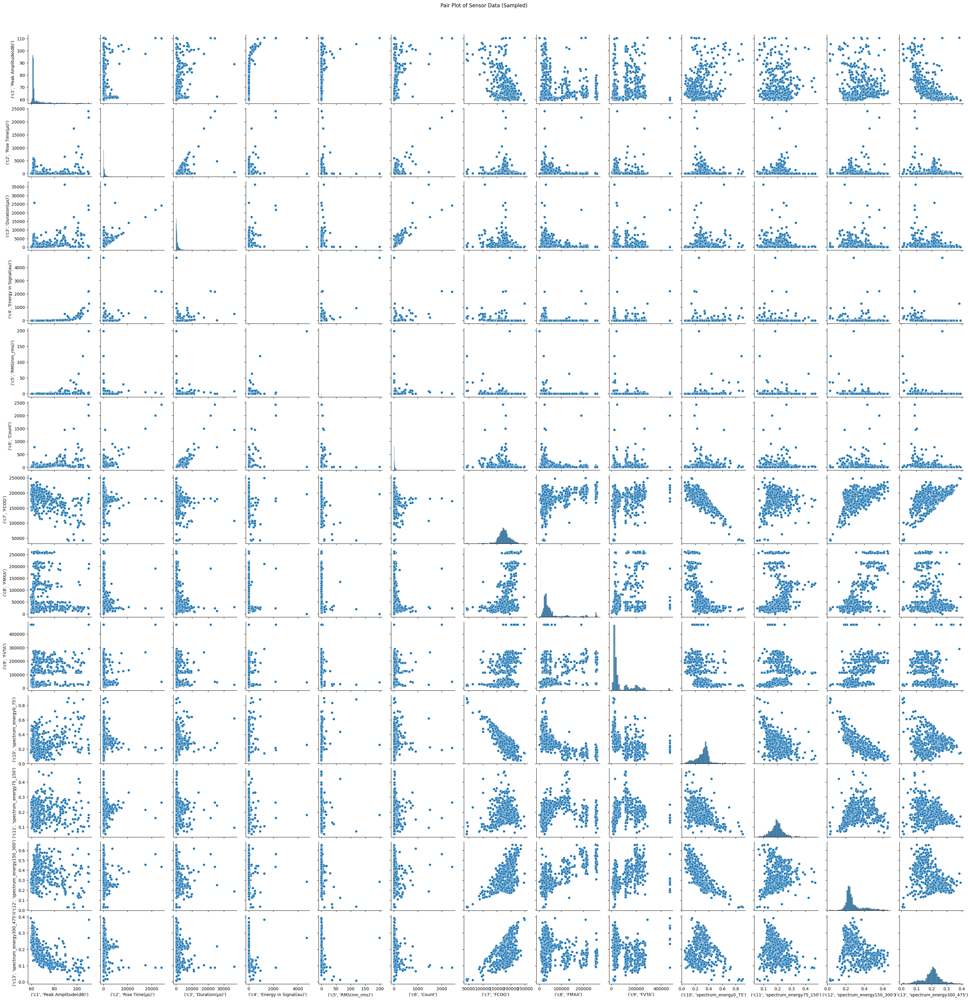

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np

# Load data from the first 13 columns of each file
file_names = [
    "CAE1_32_64_20_512_8_10_20.xlsx",
    "CAE2_32_64_20_512_8_100_256.xlsx",
]

# Define columns to include in the pair plot
columns_to_include = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]  # First 13 columns

# Sample size for pair plot
sample_size = 1000

# Create an empty list to hold sampled dataframes
sampled_dataframes = []

for file_name in file_names:
    df = pd.read_excel(file_name, header=[0, 1])

    # Sample a subset of rows
    sampled_df = df.sample(sample_size, random_state=42)

    # Select columns to include in pair plot
    sampled_df = sampled_df.iloc[:, columns_to_include]

    sampled_dataframes.append(sampled_df)

# Combine the sampled dataframes
combined_sampled_df = pd.concat(sampled_dataframes)

# Create pair plots
sns.pairplot(combined_sampled_df)
plt.suptitle("Pair Plot of Sensor Data (Sampled)", y=1.02)
plt.show()


**Atempting to Use 500 of each class in the pairplots.**

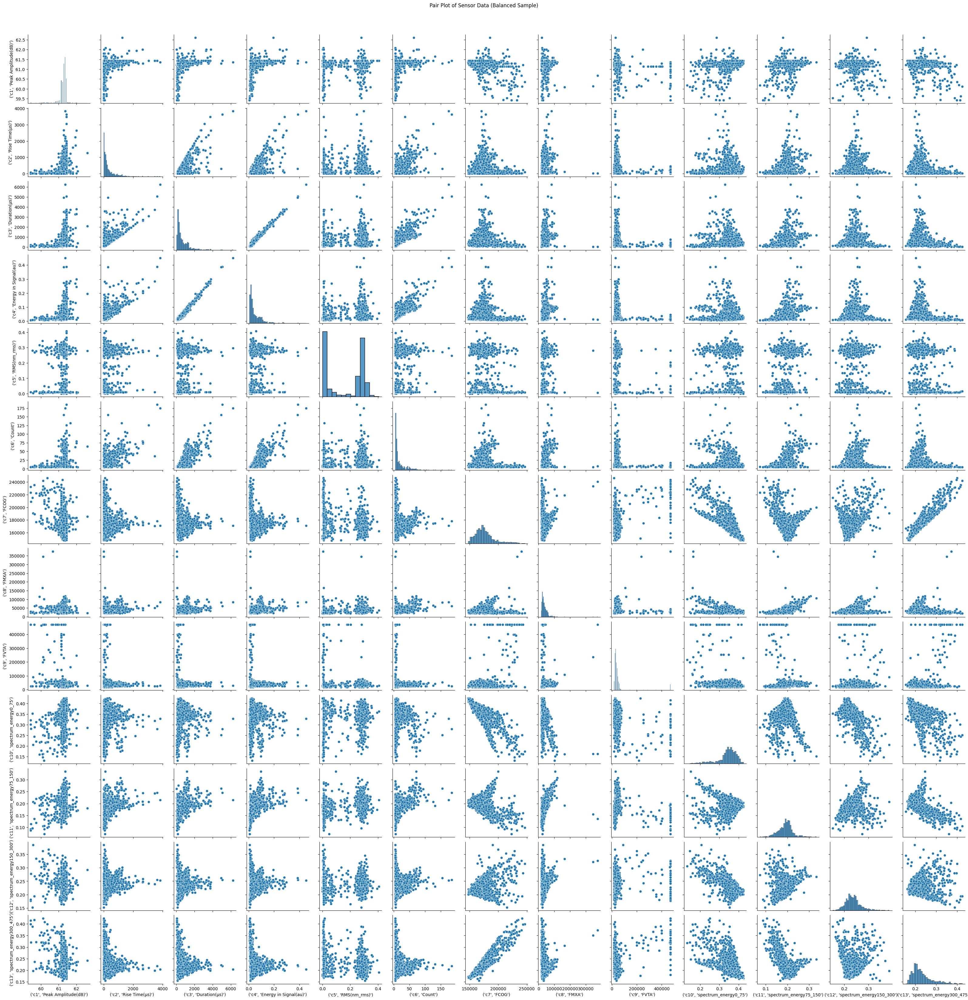

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Load data from the first 13 columns of each file
file_names = [
    "CAE1_32_64_20_512_8_10_20.xlsx",
    "CAE2_32_64_20_512_8_100_256.xlsx",
]

# Define columns to include in the pair plot
columns_to_include = [0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12]  # First 13 columns

# Sample size for each class
sample_size_per_class = 500

# Create an empty list to hold sampled dataframes
sampled_dataframes = []

for file_name in file_names:
    df = pd.read_excel(file_name, header=[0, 1])

    # Assuming the last column is the classification column
    classification_column = df.columns[-1]

    # Select rows with class 0
    class_0_df = df[df[classification_column] == 0].head(sample_size_per_class)

    # Select rows with class 1
    class_1_df = df[df[classification_column] == 1].head(sample_size_per_class)

    # Concatenate the sampled dataframes
    sampled_df = pd.concat([class_0_df, class_1_df])

    # Select columns to include in pair plot
    sampled_df = sampled_df.iloc[:, columns_to_include]

    sampled_dataframes.append(sampled_df)

# Combine the sampled dataframes
combined_sampled_df = pd.concat(sampled_dataframes)

# Create pair plots
sns.pairplot(combined_sampled_df)
plt.suptitle("Pair Plot of Sensor Data (Balanced Sample)", y=1.02)
plt.show()


**Atempt unsucessful. Forgot to add "class" as the color.**

Processing file: CAE1_32_64_20_512_8_10_20.xlsx
Processing file: CAE2_32_64_20_512_8_100_256.xlsx


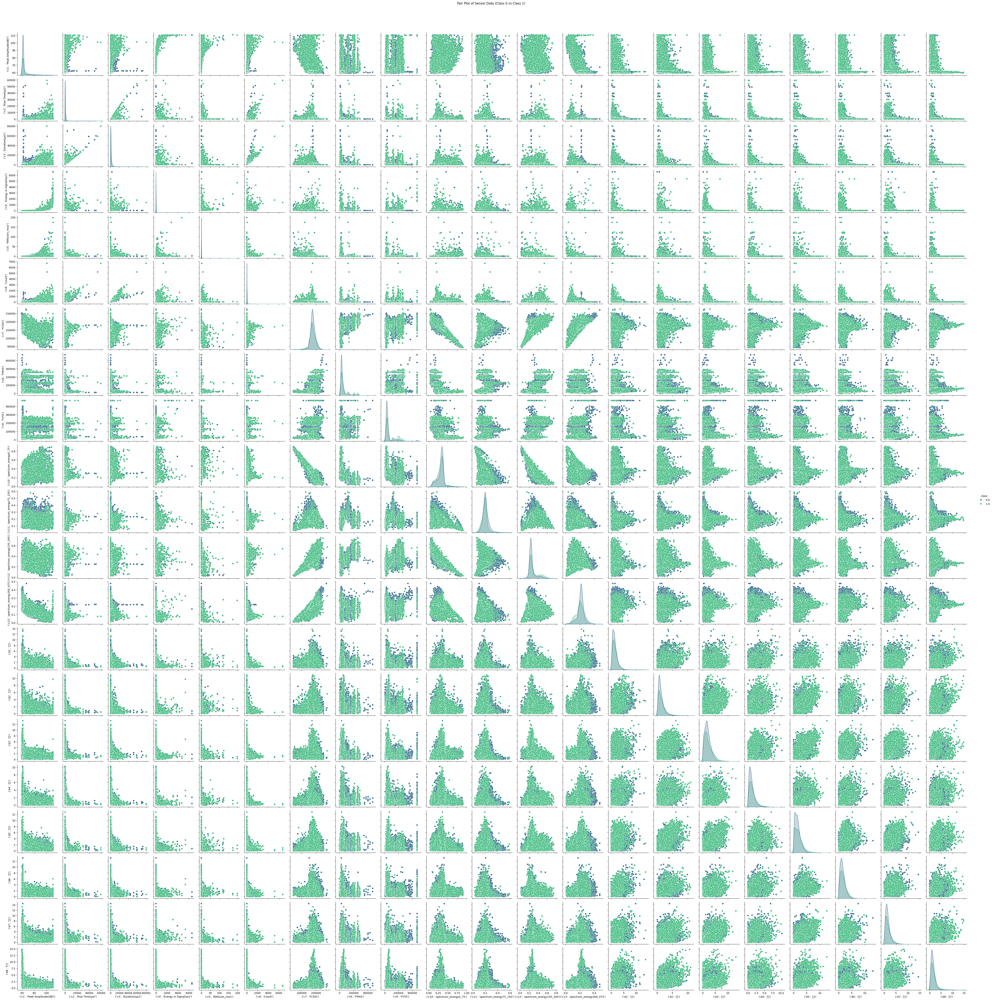

In [ ]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt

# Define the file names
file_names = [
    "CAE1_32_64_20_512_8_10_20.xlsx",
    "CAE2_32_64_20_512_8_100_256.xlsx",
]

def load_data(file_name):
    # Load data
    df = pd.read_excel(file_name, header=[0, 1])  # Load with multi-level header
    feature_names = df.columns.to_flat_index()  # Get multi-level index
    X = df.values[:, :-1]  # Features (remove the last column which is the class label)
    y = df.values[:, -1]   # Class labels (last column)
    return X, y, feature_names

# Create a DataFrame for the sampled data
sampled_dataframes = []

# Iterate over each file
for file_name in file_names:
    print("Processing file:", file_name)
    X, y, feature_names = load_data(file_name)
    sampled_df = pd.DataFrame(X, columns=feature_names[:-1])  # Create DataFrame with feature columns
    sampled_df['class'] = y  # Add the 'class' column for coloring
    sampled_dataframes.append(sampled_df)  # Append to the list of DataFrames

# Combine all sampled DataFrames into one
combined_sampled_df = pd.concat(sampled_dataframes, ignore_index=True)

# Create pair plots with hue for class coloring
sns.pairplot(combined_sampled_df, hue='class', palette='viridis')
plt.suptitle("Pair Plot of Sensor Data (Class 0 vs Class 1)", y=1.02)
plt.show()

